# MPRNet on Image Denoising

## Git clone [MPRNet](https://github.com/swz30/MPRNet) repo

In [1]:
!git clone https://github.com/swz30/MPRNet
%cd MPRNet
%pwd

c:\Users\User\Documents\GitHub\NYCU-Digital-Image-Process\MPRNet


fatal: destination path 'MPRNet' already exists and is not an empty directory.


'c:\\Users\\User\\Documents\\GitHub\\NYCU-Digital-Image-Process\\MPRNet'

## Set up the enviroment

### Your python must be **python 3.7**

### install pytorch 1.1 & cuda 9.0
* You may need to change the cmd line below to the new line from the [link](https://pytorch.org/get-started/locally/) depeding on **your os**.
* I recommend you to run the installation cmd in your terminal rather than in jupyter notebook.

In [ ]:
!conda install pytorch==1.1 torchvision==0.3 cudatoolkits==9.0 -c pytorch

### install python packages 

In [2]:
!pip install matplotlib scikit-image opencv-python yacs joblib natsort h5py tqdm gdown

   ---------------------------------------- 0.0/2.9 MB ? eta -:--:--
   -------------- ------------------------- 1.0/2.9 MB 7.2 MB/s eta 0:00:01
   ------------------------------------ --- 2.6/2.9 MB 7.2 MB/s eta 0:00:01
   ---------------------------------------- 2.9/2.9 MB 7.0 MB/s eta 0:00:00

   ---------- ----------------------------- 1/4 [natsort]
   ---------- ----------------------------- 1/4 [natsort]
   ---------- ----------------------------- 1/4 [natsort]
   ---------- ----------------------------- 1/4 [natsort]
   ---------- ----------------------------- 1/4 [natsort]
   ---------- ----------------------------- 1/4 [natsort]
   ---------- ----------------------------- 1/4 [natsort]
   -------------------- ------------------- 2/4 [joblib]
   -------------------- ------------------- 2/4 [joblib]
   -------------------- ------------------- 2/4 [joblib]
   ------------------------------ --------- 3/4 [h5py]
   ------------------------------ --------- 3/4 [h5py]
   ------------

In [3]:
!cd pytorch-gradual-warmup-lr; python setup.py install; cd ..

�t�Χ䤣����w�����|�C


## Download pretrained models

### denoise model

In [ ]:
import gdown
import os
model_folder = './Denoising/pretrained_models/'

os.makedirs(model_folder, exist_ok=True)
# Dowload from https://drive.google.com/file/d/1LODPt9kYmxwU98g96UrRA0_Eh5HYcsRw/view

### deblur model

In [21]:
import gdown
import os
model_folder = './Deblurring/pretrained_models/'

os.makedirs(model_folder, exist_ok=True)
# Download from https://drive.google.com/file/d/1QwQUVbk6YVOJViCsOKYNykCsdJSVGRtb/view

# Preparation

In [16]:
import torch

import glob
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os

def imread(img_path):
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

def display(img1, img2):
  fig = plt.figure(figsize=(25, 10))
  ax1 = fig.add_subplot(1, 2, 1)
  plt.title('Input image', fontsize=16)
  ax1.axis('off')
  ax2 = fig.add_subplot(1, 2, 2)
  plt.title('NAFNet output', fontsize=16)
  ax2.axis('off')
  ax1.imshow(img1)
  ax2.imshow(img2)

def display3(img1, img2, img3):
  fig = plt.figure(figsize=(25, 10))
  ax1 = fig.add_subplot(1, 3, 1)
  plt.title('Input image', fontsize=16)
  ax1.axis('off')
  ax2 = fig.add_subplot(1, 3, 2)
  plt.title('NAFNet output', fontsize=16)
  ax2.axis('off')
  ax3 = fig.add_subplot(1, 3, 3)
  plt.title('NAFNet output', fontsize=16)
  ax3.axis('off')
  ax1.imshow(img1)
  ax2.imshow(img2)
  ax3.imshow(img3)


# Inference and Show results

In [17]:
input_folder="../original_images/"
output_denoise_folder="../mprnet_denoise_output/"
task="Denoising"

!python demo.py --task {task} --input_dir {input_folder} --result_dir {output_denoise_folder}

Files saved at ../mprnet_denoise_output/


In [23]:
input_folder="../mprnet_denoise_output/"
output_denoise_folder="../mprnet_deblur_output/"
task="Deblurring"

!python demo.py --task {task} --input_dir {input_folder} --result_dir {output_denoise_folder}

Files saved at ../mprnet_deblur_output/


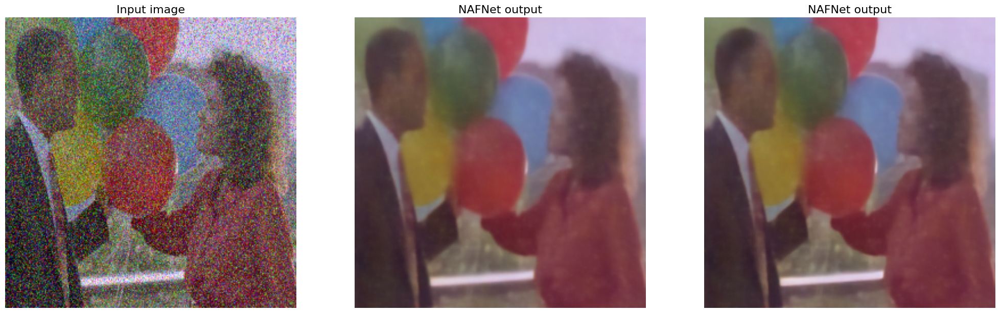

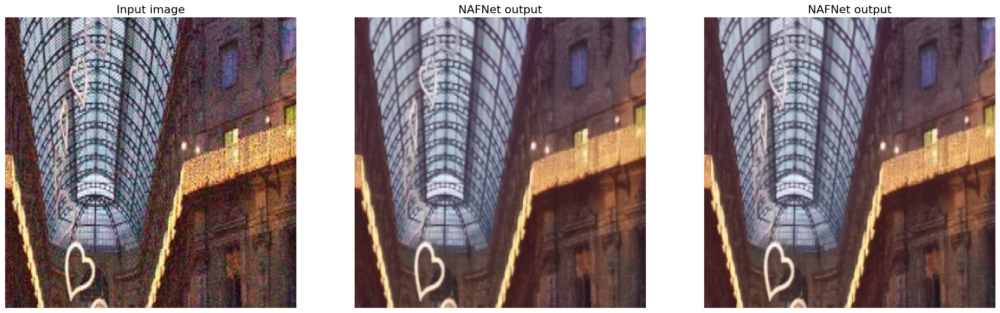

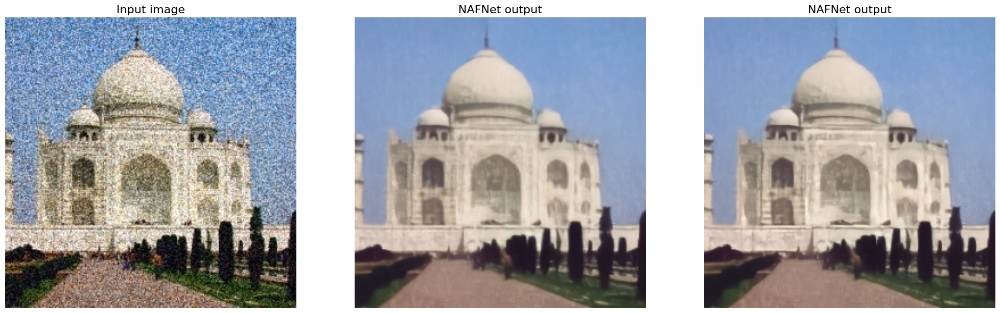

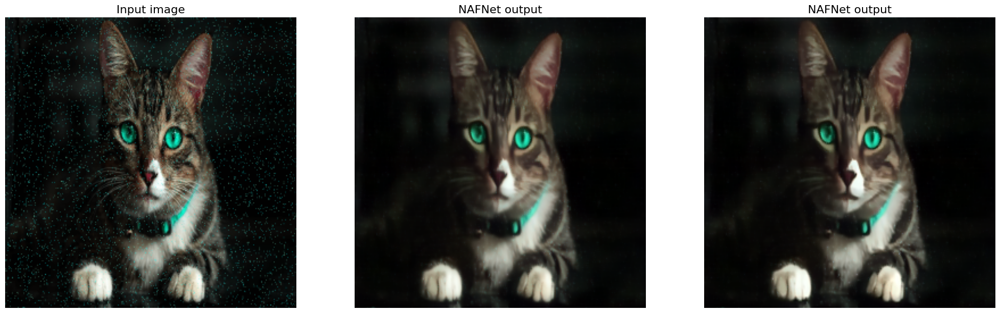

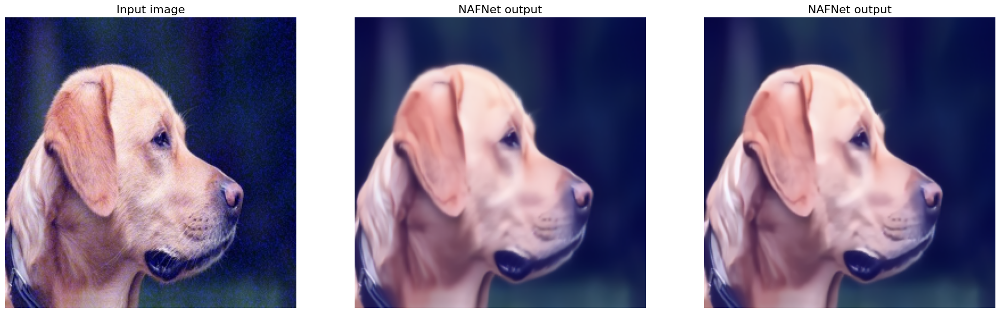

...

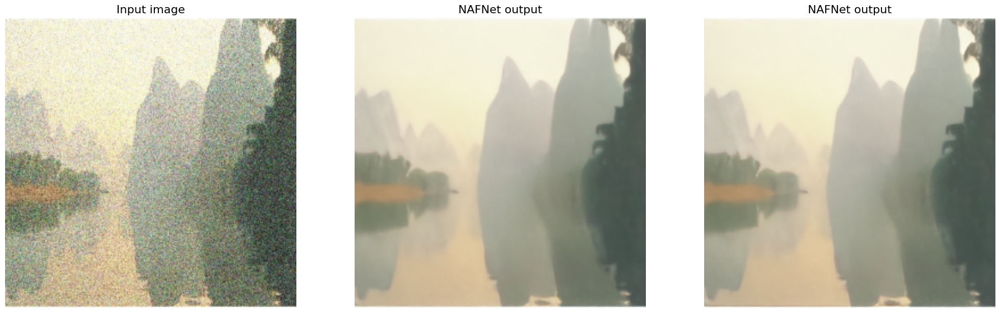

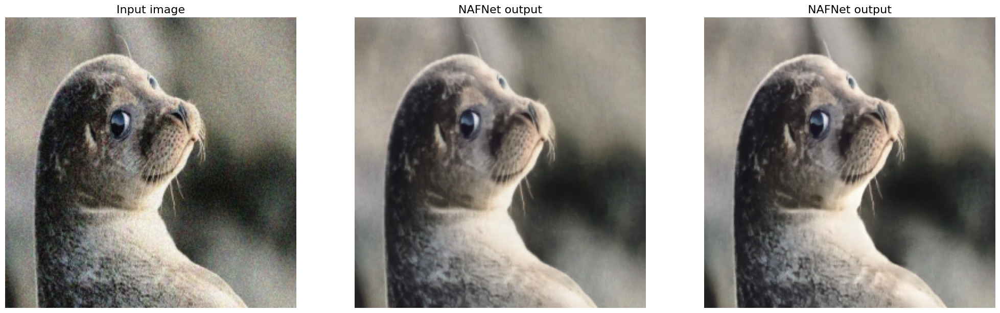

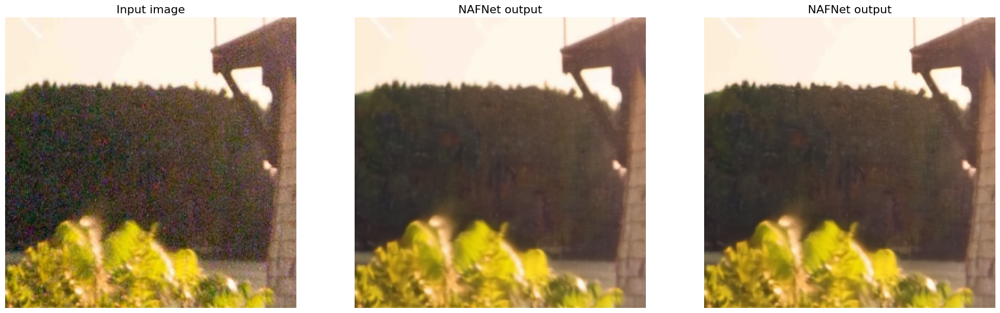

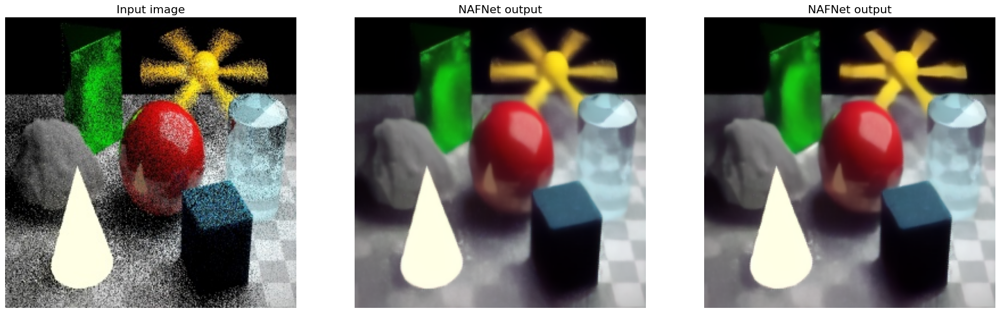

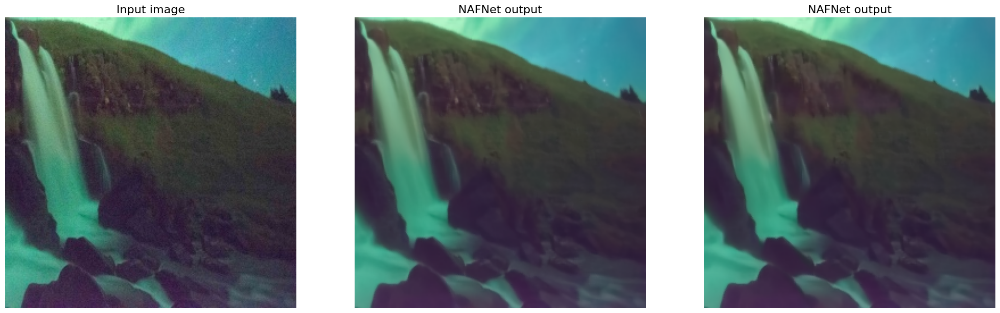

In [24]:
input_folder="../original_images/"
output_denoise_folder="../mprnet_denoise_output/"
output_deblur_folder="../mprnet_deblur_output/"


for file in os.listdir(input_folder) :
    input_path = os.path.join(input_folder, file)
    
    file_name_no_ext = os.path.splitext(file)[0]
    possible_outputs = glob.glob(os.path.join(output_denoise_folder, f"{file_name_no_ext}.*"))
    if not possible_outputs:
        continue 
    output_path = possible_outputs[0]
    
    possible_outputs = glob.glob(os.path.join(output_deblur_folder, f"{file_name_no_ext}.*"))
    if not possible_outputs:
        continue 
    output_deblur_path = possible_outputs[0]
    
    # original -> denoised
    img_input = imread(input_path)    
    img_output = imread(output_path)    
    # denoised -> deblurred 
    img_deblurred_output = imread(output_deblur_path)
    display3(img_input, img_output, img_deblurred_output)